<a href="https://colab.research.google.com/github/RunwuXu/GEOG5990M/blob/main/Assignment2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Research background
Residential Mobility is an important indicator of community vitality and residents' quality of life, and is closely related to regional economic development and social resource allocation. The residential mobility index estimates the "churn rate" of the UK's resident population, that is, the proportion of households that change from the beginning of each year to the end of the year. The UK government quantifies regional poverty through the Index of Multiple Deprivation (IMD) system, which covers seven core dimensions such as income, employment, and education. In recent years, there has been a significant trend of population redistribution in the UK, and exploring the impact of poverty on residents' migration decisions has important policy significance.
#Research objectives
This study uses Lincolnshire as the research area and aims to answer the following key questions through spatial data analysis methods:
1. Is there a statistically significant correlation between the deprivation index (IMD Score) and residential mobility?
2. Heterogeneity of the impact of different deprivation dimensions (income, education, health, etc.) on mobility
3. Deprivation index and spatial distribution of residential mobility

#Data source
This study integrates multi-source open data:

Indices of Deprivation: https://data.cdrc.ac.uk/dataset/cdrc-residential-mobility-index

CDRC Residential Mobility Index: https://data.cdrc.ac.uk/dataset/cdrc-residential-mobility-index

Lincolnshire Boundaries: https://www.data.gov.uk/dataset/c604736d-88e1-4cf3-aecc-043e72ef75e2/boundaries2



In [ ]:
# Install necessary library
!pip install mapclassify
!pip install contextily

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 65.9 MB/s eta 0:00:00


# Data Cleaning
1. **Deprivation index data**
- Read the `indicesofdeprivation.csv` dataset, including geocode (`GeoCode`), Index of Multiple Deprivation (`IMD_Score`) and sub-dimensional indicators
- Preliminary diagnosis of data scale (number of rows and columns), field composition and missing value distribution

2. **Residential mobility data**
- Load the `hh_churn_lsoa11_2023.csv` dataset, filter and retain key fields:
- `area` (geocode)
- `chn2019` (2019 Residential Mobility Index, renamed `Residential_Mobility_2019`)
Detect missing value distribution

3. **Data merging**
- Integrate poverty data and mobility data through left join (`left join`), with matching keys:
- Deprivation data: `GeoCode`
- Mobility data: `area`

4. **Missing value detection**


In [ ]:
# Import necessary package
import geopandas as gpd # Geospatial data manipulation
import pandas as pd   # Data manipulation and analysis
import matplotlib.pyplot as plt # Data visualization
import seaborn as sns
import numpy as np
import contextily as ctx

# Read the Indices of Deprivation CSV file
deprivation=pd.read_csv("indicesofdeprivation.csv")

# Inspect column names of the loaded DataFrame
deprivation.columns

Index(['OrganisationLabel', 'OrganisationURI', 'PublishedDate', 'DurationFrom',
       'DurationTo', 'LatestData', 'GeoAreaDescription', 'GeoEntityName',
       'GeoCode', 'GeoName', 'GeoURI', 'Year', 'LocalAuthorityDistrictCode',
       'LocalAuthorityDistrictName', 'IMD_Score', 'IMD_Rank(1MostDeprived)',
       'IMD_Decile(1MostDeprivedTenPerCentOfLSOAs)', 'Income_Score(Rate)',
       'Income_Rank(1MostDeprived)',
       'Income_Decile(1MostDeprivedTenPerCentOfLSOAs)',
       'Employment_Score(Rate)', 'Employment_Rank(1MostDeprived)',
       'Employment_Decile(1MostDeprivedTenPerCentOfLSOAs)',
       'EducationSkillsAndTraining_Score',
       'EducationSkillsAndTraining_Rank(1MostDeprived)',
       'EducationSkillsAndTraining_Decile(1MostDeprivedTenPerCentOfLSOAs)',
       'HealthDeprivAndDisability_Score',
       'HealthDeprivAndDisability_Rank(1MostDeprived)',
       'HealthDeprivAndDisability_Decile(1MostDeprivedTenPerCentOfLSOAs)',
       'Crime_Score', 'Crime_Rank(1MostDeprived)

In [ ]:
deprivation.shape

(420, 67)

In [ ]:
# Display first 5 rows of the data
deprivation.head()

,OrganisationLabel,OrganisationURI,PublishedDate,DurationFrom,DurationTo,LatestData,GeoAreaDescription,GeoEntityName,GeoCode,GeoName,...,Indoors_SubDomain_Rank(1MostDeprived),Indoors_SubDomain_Decile(1MostDeprivedTenPerCentOfLSOAs),Outdoors_SubDomain_Score,Outdoors_SubDomain_Rank(1MostDeprived),Outdoors_SubDomain_Decile(1MostDeprivedTenPerCentOfLSOAs),TotalPopulation(ExclPrisoners),DependentChildrenAge0_15(ExclPrisoners),PopulationAge16_59(ExclPrisoners),OlderPopulationAge60AndOver(ExclPrisoners),WorkingAgePopn18_59Or64(ExclPrisoners)_EmploymentDeprivDomain
0,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026006,Boston 003A,...,1447,1,-0.534,23954,8,2762,501,1956,305,2006
1,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026007,Boston 001A,...,25542,8,-1.095,30228,10,1108,152,558,398,576
2,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026008,Boston 001B,...,2619,1,-0.904,28539,9,1124,134,503,487,533
3,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026009,Boston 001C,...,2845,1,-0.283,20051,7,1229,182,617,430,631
4,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026010,Boston 002A,...,25102,8,-1.043,29793,10,1548,396,936,216,930


In [ ]:
# Calculate total missing values
deprivation.isnull().sum()

,0
OrganisationLabel,0
OrganisationURI,0
PublishedDate,0
DurationFrom,0
DurationTo,0
...,...
TotalPopulation(ExclPrisoners),0
DependentChildrenAge0_15(ExclPrisoners),0
PopulationAge16_59(ExclPrisoners),0
OlderPopulationAge60AndOver(ExclPrisoners),0


In [ ]:
# Read the Indices of Deprivation CSV file
mobility=pd.read_csv("hh_churn_lsoa11_2023.csv")

# Inspect column names of the loaded DataFrame
mobility.columns

Index(['area', 'chn1997', 'chn1998', 'chn1999', 'chn2000', 'chn2001',
       'chn2002', 'chn2003', 'chn2004', 'chn2005', 'chn2006', 'chn2007',
       'chn2008', 'chn2009', 'chn2010', 'chn2011', 'chn2012', 'chn2013',
       'chn2014', 'chn2015', 'chn2016', 'chn2017', 'chn2018', 'chn2019',
       'chn2020', 'chn2021', 'chn2022', 'chn2023'],
      dtype='object')

In [ ]:
# Only keep the chn2023 and area columns
mobility_filtered = mobility[["area", "chn2019"]]

mobility_filtered = mobility_filtered.rename(columns={"chn2019": "Residential_Mobility_2019"})

mobility_filtered.isnull().sum()

,0
area,0
Residential_Mobility_2019,0


In [ ]:
# Display first 5 rows of the data
mobility_filtered.head()

,area,Residential_Mobility_2019
0,95AA01S1,0.799
1,95AA01S2,0.256
2,95AA01S3,0.279
3,95AA02W1,0.243
4,95AA03W1,0.252


In [ ]:
# Join the two data
deprivation_mobility = deprivation.merge(mobility_filtered, how='left',left_on='GeoCode',right_on='area')

# Display first 5 rows of the data
deprivation_mobility.head()

,OrganisationLabel,OrganisationURI,PublishedDate,DurationFrom,DurationTo,LatestData,GeoAreaDescription,GeoEntityName,GeoCode,GeoName,...,Outdoors_SubDomain_Score,Outdoors_SubDomain_Rank(1MostDeprived),Outdoors_SubDomain_Decile(1MostDeprivedTenPerCentOfLSOAs),TotalPopulation(ExclPrisoners),DependentChildrenAge0_15(ExclPrisoners),PopulationAge16_59(ExclPrisoners),OlderPopulationAge60AndOver(ExclPrisoners),WorkingAgePopn18_59Or64(ExclPrisoners)_EmploymentDeprivDomain,area,Residential_Mobility_2019
0,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026006,Boston 003A,...,-0.534,23954,8,2762,501,1956,305,2006,E01026006,0.277
1,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026007,Boston 001A,...,-1.095,30228,10,1108,152,558,398,576,E01026007,0.126
2,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026008,Boston 001B,...,-0.904,28539,9,1124,134,503,487,533,E01026008,0.155
3,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026009,Boston 001C,...,-0.283,20051,7,1229,182,617,430,631,E01026009,0.173
4,Lincolnshire,http://opendatacommunities.org/id/county-counc...,2019-10-14T00:00:00,2019-09-26T00:00:00,2019-09-26T00:00:00,True,LSOA2011,Lower Super Output Area (LSOA),E01026010,Boston 002A,...,-1.043,29793,10,1548,396,936,216,930,E01026010,0.245


In [ ]:
# Calculate total missing values
deprivation_mobility.isnull().sum()

,0
OrganisationLabel,0
OrganisationURI,0
PublishedDate,0
DurationFrom,0
DurationTo,0
...,...
PopulationAge16_59(ExclPrisoners),0
OlderPopulationAge60AndOver(ExclPrisoners),0
WorkingAgePopn18_59Or64(ExclPrisoners)_EmploymentDeprivDomain,0
area,0


# 3. Exploratory data analysis
1. **Statistical feature description**
- Generate descriptive statistics for core variables:

2. **Visual exploration**
- Draw a scatter plot of deprivation index and residential mobility, showing:
 No obvious linear correlation trend
 No large number of outliers

In [ ]:
# Generate descriptive statistics for selected columns
deprivation_mobility[['IMD_Score','Residential_Mobility_2019']].describe()

,IMD_Score,Residential_Mobility_2019
count,420.000000,420.000000
mean,20.431664,0.192612
std,13.769940,0.067691
min,1.557000,0.068000
25%,10.290500,0.149000
50%,16.722500,0.177000
75%,26.726000,0.221000
max,81.300000,0.650000


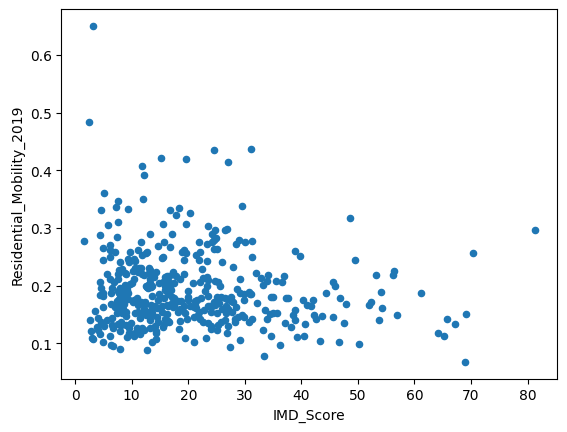

In [ ]:
deprivation_mobility.plot.scatter(x='IMD_Score',y='Residential_Mobility_2019');

# Statistical analysis and modeling

The following core variables were extracted from the original data:
- **Housing mobility**: `Residential_Mobility_2019` (2019 residential mobility index)
- **Comprehensive poverty index**: `IMD_Score` (comprehensive score covering income, employment and other dimensions)
- **Sub-dimension poverty indicators**: income poverty (`Income_Score`), employment poverty (`Employment_Score`), education poverty (`EducationSkillsAndTraining_Score`), health poverty (`HealthDeprivAndDisability_Score`), crime rate (`Crime_Score`), housing barriers (`BarriersToHousingAndServices_Score`) and living environment (`LivingEnvironmentScore`)

## Correlation analysis
**Spearman rank correlation coefficient** was used to understand the relationship between residential mobility and the indicator of multiple poverty.

## Regression modeling analysis
Build an ordinary least squares (OLS) linear regression model with housing mobility as the dependent variable and the comprehensive poverty index as the independent variable.

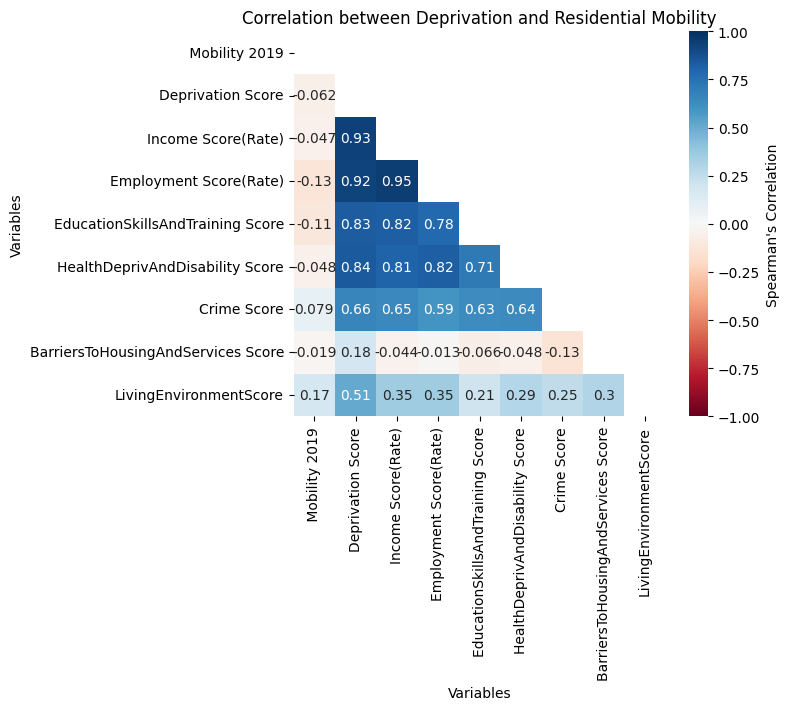

In [ ]:
# Extract target column
target_columns = ['Residential_Mobility_2019','IMD_Score', 'Income_Score(Rate)', 'Employment_Score(Rate)', 'EducationSkillsAndTraining_Score', 'HealthDeprivAndDisability_Score', 'Crime_Score', 'BarriersToHousingAndServices_Score','LivingEnvironmentScore']
correlation_data = deprivation_mobility[target_columns]


# Calculate the correlation coefficient matrix
corr_matrix = correlation_data.corr(method='spearman')

# Process axis labels
x_axis_labels = [col.replace('_', ' ').replace('IMD', 'Deprivation').replace('Residential', '') for col in corr_matrix.columns]
y_axis_labels = [col.replace('_', ' ').replace('IMD', 'Deprivation').replace('Residential', '') for col in corr_matrix.index]

fig, ax = plt.subplots(figsize=(6, 5))

# Define the mask
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

sns.heatmap(
    corr_matrix,
    annot=True,
    cmap='RdBu',               # Red-blue gradient
    vmin=-1, vmax=1,           # The color range is fixed to [-1, 1]
    mask=mask,                 # Apply mask
    xticklabels=x_axis_labels, # Customize X-axis labels
    yticklabels=y_axis_labels, # Customize y-axis labels
    cbar_kws={'label': "Spearman's Correlation"},
    ax=ax
)

# Set title and axis labels
ax.set(
    xlabel="Variables",
    ylabel="Variables",
    title="Correlation between Deprivation and Residential Mobility"
)
plt.show()


The results show that the correlation between mobility and IMD is -0.06, indicating that there is almost no linear relationship between the two. Among them, the employment deprivation index has the strongest negative correlation with mobility, which may reflect that it is more difficult for residents to move or relocate in areas with a lack of employment opportunities.

At the same time, the living environment score is positively correlated with mobility (r = 0.17), which may indicate that areas with good environmental conditions are more attractive to people moving in.

Overall, although some deprivation sub-indicators have a consistent trend with residential mobility, the correlation is generally weak, and more complex modeling methods, such as regression analysis, may be needed to further explore the relationship between variables.

In [ ]:
import statsmodels.api as sm

X = deprivation_mobility[["IMD_Score"]]  # Independent variables
y = deprivation_mobility["Residential_Mobility_2019"]  # Dependent variable
X = sm.add_constant(X)  # Add intercept term

# Fitting a linear regression model
model = sm.OLS(y, X).fit()
print(model.summary())

                                OLS Regression Results                               
Dep. Variable:     Residential_Mobility_2019   R-squared:                       0.011
Model:                                   OLS   Adj. R-squared:                  0.008
Method:                        Least Squares   F-statistic:                     4.530
Date:                       Tue, 13 May 2025   Prob (F-statistic):             0.0339
Time:                               02:16:08   Log-Likelihood:                 537.79
No. Observations:                        420   AIC:                            -1072.
Df Residuals:                            418   BIC:                            -1063.
Df Model:                                  1                                         
Covariance Type:                   nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------

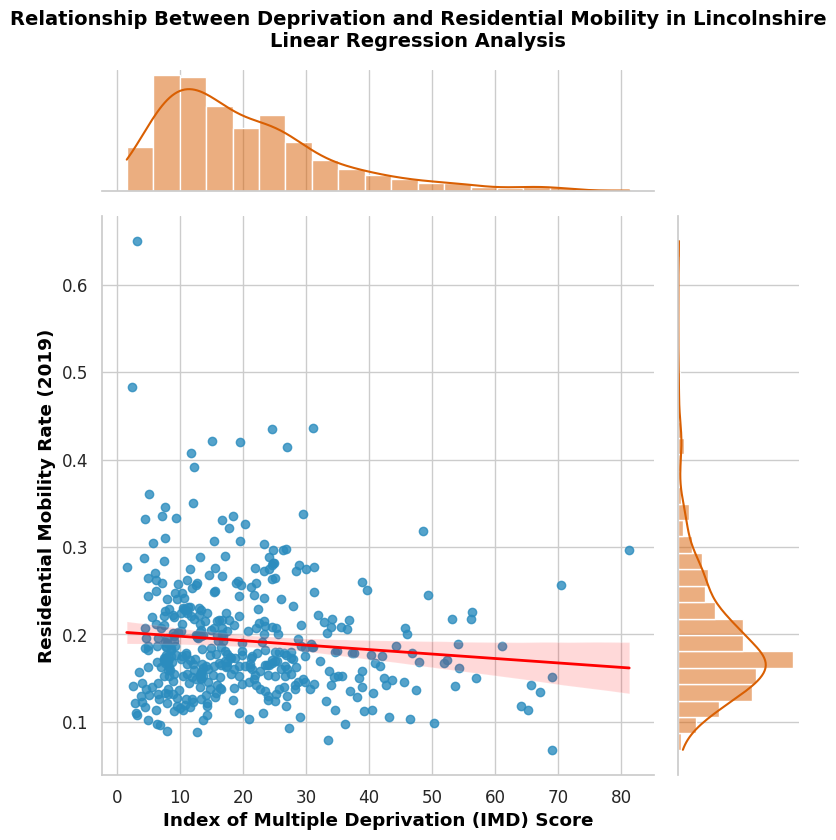

In [ ]:
sns.set_theme(
    style="whitegrid",  # Clean grid background
    font_scale=1.1,  # Larger text for readability
    rc={"axes.labelcolor": "black", "text.color": "black"}  # High-contrast text
)

# Generate jointplot with improvements
jp = sns.jointplot(
    x='IMD_Score',
    y='Residential_Mobility_2019',
    data=deprivation_mobility,
    kind='reg',  # Regression line for trend analysis
    height=8,  # Increase figure size
    ratio=4,  # Adjust marginal plot ratio
    color='#2b8cbe',  # Colorblind-friendly blue (Brewer, 1999)
    marginal_kws={'color': '#d95f02'},  # Complementary marginal plot color
    line_kws={'color': 'red', 'lw': 2}  # Emphasize regression line
)

# Customize titles and labels
jp.ax_joint.set_xlabel('Index of Multiple Deprivation (IMD) Score', fontweight='bold')
jp.ax_joint.set_ylabel('Residential Mobility Rate (2019)', fontweight='bold')
plt.suptitle(
    'Relationship Between Deprivation and Residential Mobility in Lincolnshire\nLinear Regression Analysis',
    y=1.05,  # Adjust title position
    fontsize=14,
    fontweight='bold'
)
plt.show()

The impact of the IMD on the residential mobility index was analyzed using the ordinary least squares (OLS) model.

- The R² of the model is 0.011, indicating that IMD can only explain 1.1% of the variation in residential mobility and has very weak predictive power.
- The regression coefficient of IMD is -0.0005 and is statistically significant (p = 0.034). This indicates that for every unit increase in deprivation, residential mobility decreases by 0.0005 units on average, indicating a very weak negative relationship.
- However, the Jarque-Bera test of the model residuals shows that the residuals are seriously not normally distributed (p < 0.001), and the skewness and fat tails are obvious, indicating that the assumptions of the OLS model may not hold.
- The Durbin-Watson statistic is 1.56, slightly lower than the ideal value of 2, suggesting that the residuals may have some autocorrelation, which is common in spatial data.

Although the regression coefficient is statistically significant, its explanatory power is very limited, and the residual distribution is not ideal, indicating that the model is weak in actual predictive ability and the relationship between residential mobility and deprivation is weak.

## Spatial Visualization: IMD Score and Residential Mobility Heat Map

This section presents the spatial distribution of deprivation and residential mobility in each LSOA area in Lincolnshire in the form of a map, aiming to explore the differences in spatial patterns of the two in geography and provide an intuitive basis for local policy making.

### Data Processing:

After merging the LSOA geographic boundaries with the deprivation and residential mobility data by GeoCode, it was found that some areas were not successfully matched. After further investigation, it was found that this may be due to inconsistent data years. The LSOA boundaries are the 2021 version, while the deprivation and mobility data are based on 2019, and the regional code system may have slight changes;
To ensure the integrity and coherence of spatial visualization, this article decided to fill the missing values ​​of `IMD_Score` and `Residential_Mobility_2019` in these unmatched areas with the overall average. Although this approach may mask the true local variation, it is more continuous and clear in showing the spatial trends of the entire Lincolnshire region.

### Visualization
1: IMD Score spatial distribution map: IMD Score is classified using `natural_breaks` (natural breakpoint classification method)  
2: Residential mobility heat map: It can help identify regional characteristics of high or low mobility.

In [ ]:
lincolnshire_lsoa = gpd.read_file('lower-super-output-areas-2021.geojson')

lincolnshire_lsoa.head()

,CODE,NAME,geometry
0,E01026178,Lincoln 006D,"POLYGON ((-0.54235 53.22225, -0.54233 53.22225..."
1,E01026177,Lincoln 006C,"POLYGON ((-0.54229 53.22276, -0.54223 53.22276..."
2,E01026176,Lincoln 006B,"POLYGON ((-0.53626 53.22809, -0.53591 53.22807..."
3,E01026175,Lincoln 010E,"POLYGON ((-0.5512 53.21072, -0.55123 53.21067,..."
4,E01026166,Lincoln 001C,"POLYGON ((-0.53554 53.2496, -0.53554 53.2496, ..."


In [ ]:
lincolnshire_lsoa.shape

(435, 3)

In [ ]:
# Join the spatial data
lincolnshire_deprivation_mobility = lincolnshire_lsoa.merge(deprivation_mobility, how='left',left_on='CODE',right_on='GeoCode')

In [ ]:
lincolnshire_deprivation_mobility.shape

(420, 72)

In [ ]:
missing_data = lincolnshire_deprivation_mobility[lincolnshire_deprivation_mobility['IMD_Score'].isnull()]
missing_codes = missing_data["CODE"].tolist()

# Output missing code
print("Geocoding of missing areas:", missing_codes)

Geocoding of missing areas: []


In [ ]:
# Fill missing values ​​of IMD_Score
imd_mean = lincolnshire_deprivation_mobility["IMD_Score"].mean()
lincolnshire_deprivation_mobility["IMD_Score"] = lincolnshire_deprivation_mobility["IMD_Score"].fillna(imd_mean)

# Fill missing values ​​of Residential_Mobility_2019
mobility_mean = lincolnshire_deprivation_mobility["Residential_Mobility_2019"].mean()
lincolnshire_deprivation_mobility["Residential_Mobility_2019"] = lincolnshire_deprivation_mobility["Residential_Mobility_2019"].fillna(mobility_mean)

In [ ]:
lincolnshire_deprivation_mobility["IMD_Score"].isnull().sum()

np.int64(0)

In [ ]:
lincolnshire_deprivation_mobility["Residential_Mobility_2019"].isnull().sum()

np.int64(0)

In [ ]:
lincolnshire_deprivation_mobility.explore()

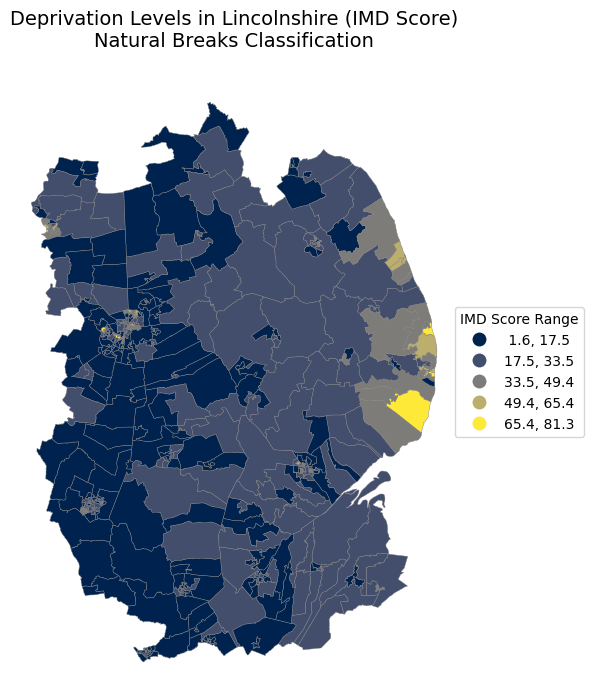

In [ ]:
fig, ax = plt.subplots(figsize=(12, 8))

# Plotting with accessibility and clarity enhancements
lincolnshire_deprivation_mobility.plot(
    column='IMD_Score',
    cmap='cividis',  # Use colorblind-friendly colormap (Nuñez et al., 2018)
    scheme='EqualInterval',  # Equal interval classification for policy relevance
    legend=True,
    legend_kwds={
        'title': 'IMD Score Range',
        'loc': 'lower right',
        'fmt': "{:.1f}",  # Format legend values to 1 decimal place
        'bbox_to_anchor': (1.3, 0.4)  # Adjust legend position to avoid overlap
    },
    edgecolor='grey',  # Add boundaries for clarity
    linewidth=0.3,
    ax=ax
)

# Title
plt.title('Deprivation Levels in Lincolnshire (IMD Score)\nNatural Breaks Classification', fontsize=14, pad=20)
ax.set_axis_off()  # Remove axes for cleaner presentation

plt.show()

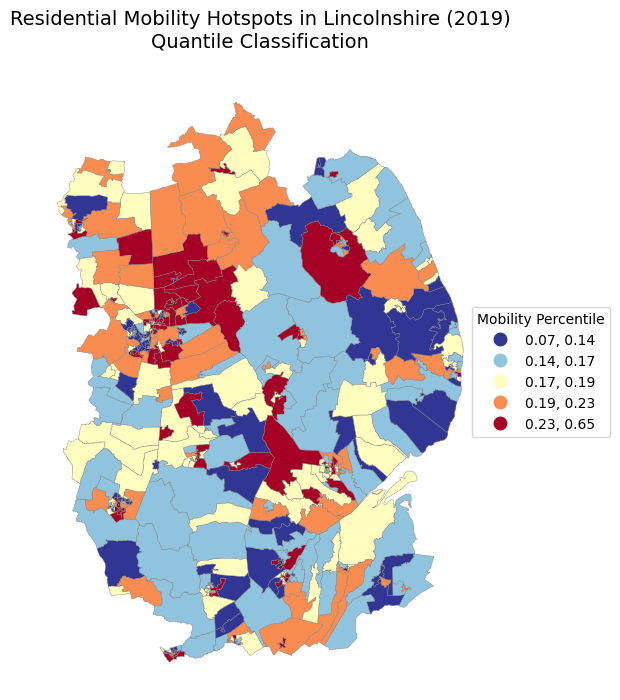

In [ ]:
ig, ax = plt.subplots(figsize=(12, 8))

# Enhanced visualization for interpretability
lincolnshire_deprivation_mobility.plot(
    column='Residential_Mobility_2019',
    cmap='RdYlBu_r',  # High-contrast colormap
    scheme='Quantiles',  # Quantile classification to highlight extremes
    legend=True,
    legend_kwds={
    'title': 'Mobility Percentile',
    'loc': 'lower right',
    'bbox_to_anchor': (1.3, 0.4)
},
    edgecolor='grey',
    linewidth=0.3,
    ax=ax
)

# Title
plt.title('Residential Mobility Hotspots in Lincolnshire (2019)\nQuantile Classification', fontsize=14, pad=20)
ax.set_axis_off()
plt.show()

### Spatial Distribution

#### Spatial distribution of Deprivation level

From the first map, it can be observed that the deprivation level in Lincolnshire shows a clear spatial aggregation pattern:
- Most areas in Lincolnshire have low deprivation levels, with IMD less than 33.5
- High deprivation areas are mainly concentrated in low-income communities on the edge of the city
- Areas with low deprivation levels are mostly distributed in cities
- Overall, the spatial distribution characteristics of deprivation levels are obvious, which may reflect the spatial differentiation of service resource concentration and social stratification.

#### Spatial distribution of residential mobility

The second residential mobility map shows:

- Areas with high mobility are mostly concentrated in cities, around transportation hubs and some areas with active social economy. These areas may have more rental housing, student housing, short-term migrants, etc.;
- Areas with low mobility are distributed in relatively inland traditional communities or rural areas

Combining the two maps, suburban and rural areas with high poverty levels have low residential mobility; urban areas with low poverty levels have high residential mobility

## Summary
This study uses Lincolnshire as a case study area and combines open access geospatial data to analyze the spatial relationship between IMD and the Residential Mobility Index. Although the overall regression model shows a weak linear relationship between the two, spatial visualization reveals that some areas have an overlapping pattern of "high poverty + low mobility", reflecting the dual dilemma of specific communities in terms of socioeconomic and residential mobility.

### Target audience of the study

The results of this study are aimed at the following three key audiences and provide them with a practical information basis:

- **Policy Makers**:
- This study can be used to identify "spatially disadvantaged" areas with limited residential mobility and high poverty levels;
- It can help to formulate more targeted housing support policies, community intervention plans and social mobility promotion measures.

- **Local Authorities & Urban Planners**:
- It can be used to assist in the optimization of urban spatial structure, resource redistribution and community sustainable development planning;
- It can help understand the potential relationship between poverty distribution and urban expansion and transportation networks.

- **Commercial & Housing Sector Stakeholders**:
- Can be used to identify high mobility hotspots and evaluate rental market opportunities;
- Provide data reference when planning new project sites or evaluating population mobility trends.